In [1]:
import cv2
import matplotlib.pyplot as plt
import numpy as np
%matplotlib inline

In [2]:
def load_img():
    img = cv2.imread('../DATA/bricks.jpg').astype(np.float32) / 255
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    return img

In [3]:
def display_img(img):
    fig = plt.figure(figsize=(15,15))
    ax = fig.add_subplot(111)
    ax.imshow(img, cmap='gray')

# Color Mappings

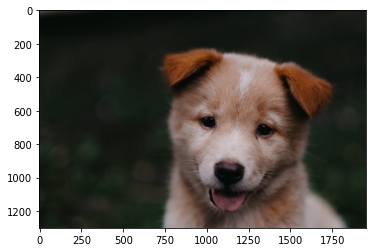

In [4]:
img = cv2.imread('../DATA/00-puppy.jpg')
img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
plt.imshow(img)

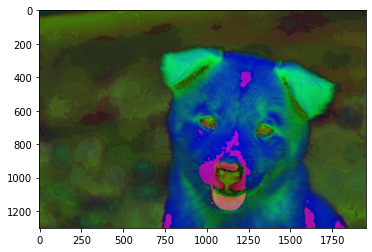

In [5]:
img = cv2.imread('../DATA/00-puppy.jpg')
img = cv2.cvtColor(img, cv2.COLOR_BGR2HSV)
plt.imshow(img)

# Blending and Pasting Images

In [6]:
img1 = cv2.imread('../DATA/dog_backpack.jpg')
img1 = cv2.cvtColor(img1, cv2.COLOR_BGR2RGB)
img2 = cv2.imread('../DATA/watermark_no_copy.png')
img2 = cv2.cvtColor(img2, cv2.COLOR_BGR2RGB)

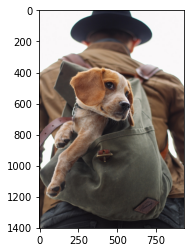

In [7]:
plt.imshow(img1)

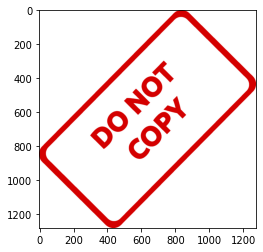

In [8]:
plt.imshow(img2)

In [10]:
# Image sizes
print(img1.shape)
print(img2.shape)

(1401, 934, 3)
(1280, 1277, 3)


In [11]:
img1 = cv2.resize(img1, (1200, 1200))
img2 = cv2.resize(img2, (1200, 1200))

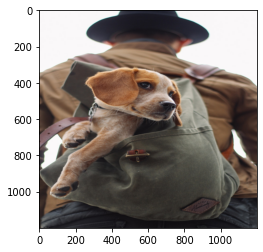

In [12]:
plt.imshow(img1)

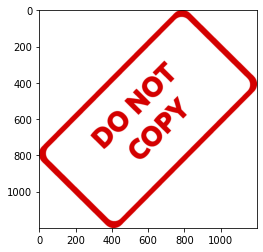

In [13]:
plt.imshow(img2)

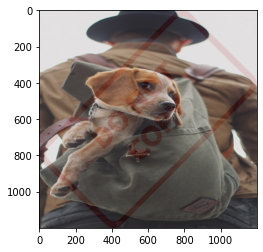

In [16]:
blended = cv2.addWeighted(src1=img1, alpha=0.8, src2=img2, beta=0.1, gamma=0)
plt.imshow(blended)

In [17]:
# OVERLAY SMALL IMAGE ON TOP OF A LARGER IMAGE (NO BLENDING)

img1 = cv2.imread('../DATA/dog_backpack.jpg')
img1 = cv2.cvtColor(img1, cv2.COLOR_BGR2RGB)
img2 = cv2.imread('../DATA/watermark_no_copy.png')
img2 = cv2.cvtColor(img2, cv2.COLOR_BGR2RGB)

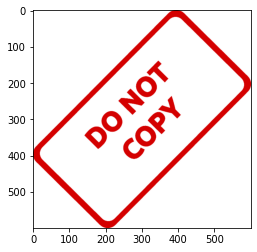

In [18]:
img2 = cv2.resize(img2, (600, 600))
plt.imshow(img2)

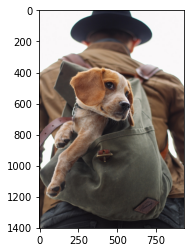

In [19]:
plt.imshow(img1)

In [20]:
large_img = img1
small_img = img2

In [21]:
x_offset = 0
y_offset = 0

In [22]:
x_end = x_offset + small_img.shape[1]
y_end = y_offset + small_img.shape[0]

In [23]:
small_img.shape

(600, 600, 3)

In [24]:
large_img[y_offset:y_end,x_offset:x_end] = small_img

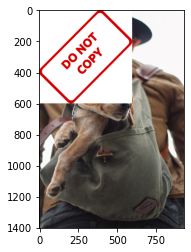

In [25]:
plt.imshow(large_img)

# Masks

In [28]:
img1 = cv2.imread('../DATA/dog_backpack.jpg')
img1 = cv2.cvtColor(img1, cv2.COLOR_BGR2RGB)
img2 = cv2.imread('../DATA/watermark_no_copy.png')
img2 = cv2.cvtColor(img2, cv2.COLOR_BGR2RGB)

img2 = cv2.resize(img2, (600, 600))

In [29]:
img1.shape

(1401, 934, 3)

In [30]:
x_offset = 934 - 600
y_offset = 1401 - 600

In [32]:
rows, cols, _ = img2.shape

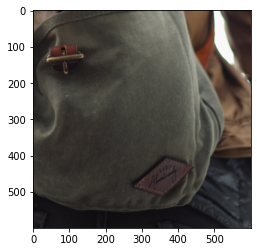

In [34]:
roi = img1[y_offset:1401,x_offset:943]

plt.imshow(roi)

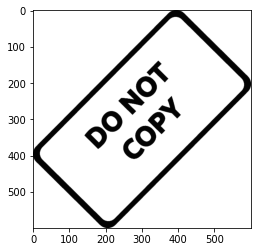

In [35]:
img2gray = cv2.cvtColor(img2,cv2.COLOR_RGB2GRAY)
plt.imshow(img2gray,cmap="gray")

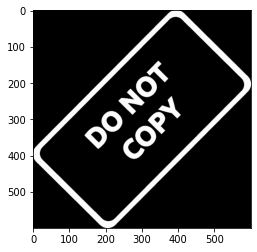

In [36]:
mask_inv = cv2.bitwise_not(img2gray)
plt.imshow(mask_inv,cmap="gray")

In [38]:
mask_inv.shape

(600, 600)

In [40]:
white_background = np.full(img2.shape,255,dtype=np.uint8)
white_background.shape

(600, 600, 3)

In [41]:
bk = cv2.bitwise_or(white_background,white_background,mask=mask_inv)
bk.shape

(600, 600, 3)

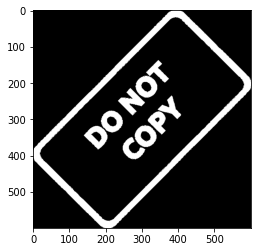

In [42]:
plt.imshow(bk)

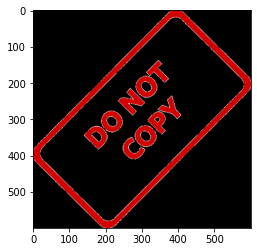

In [43]:
fg = cv2.bitwise_or(img2,img2,mask=mask_inv)
plt.imshow(fg)

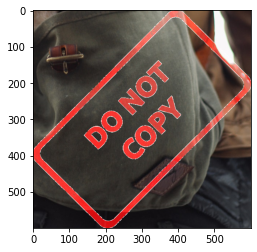

In [44]:
final_roi = cv2.bitwise_or(roi, fg)
plt.imshow(final_roi)

In [45]:
large_img = img1
small_img = final_roi

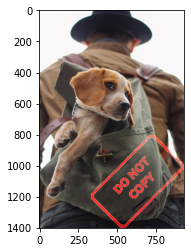

In [48]:
large_img[y_offset:y_offset+small_img.shape[0],x_offset:x_offset+small_img.shape[1]] = small_img
plt.imshow(large_img)

# Image Thresholding

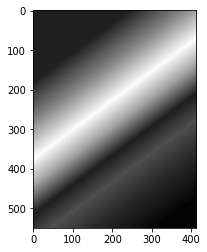

In [52]:
img = cv2.imread('../DATA/rainbow.jpg', 0)
plt.imshow(img, cmap='gray')

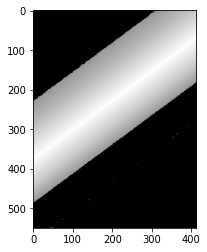

In [56]:
ret, thres1 = cv2.threshold(img, 127, 255, cv2.THRESH_TOZERO)
plt.imshow(thres1,cmap='gray')

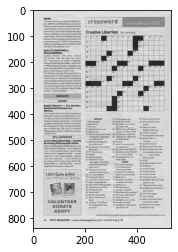

In [58]:
img = cv2.imread('../DATA/crossword.jpg',0)
plt.imshow(img, cmap='gray')

In [60]:
def show_pic(img):
    fig = plt.figure(figsize=(15,15))
    ax = fig.add_subplot(111)
    ax.imshow(img, cmap='gray')

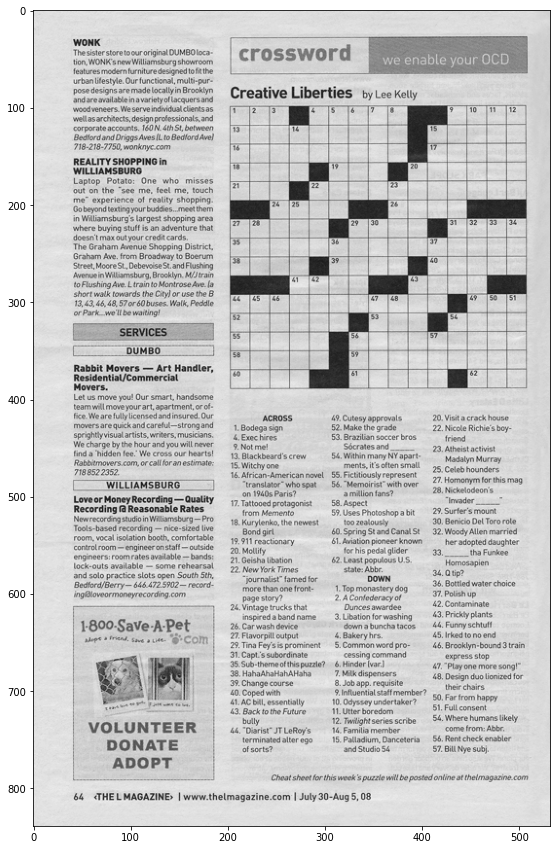

In [61]:
show_pic(img)

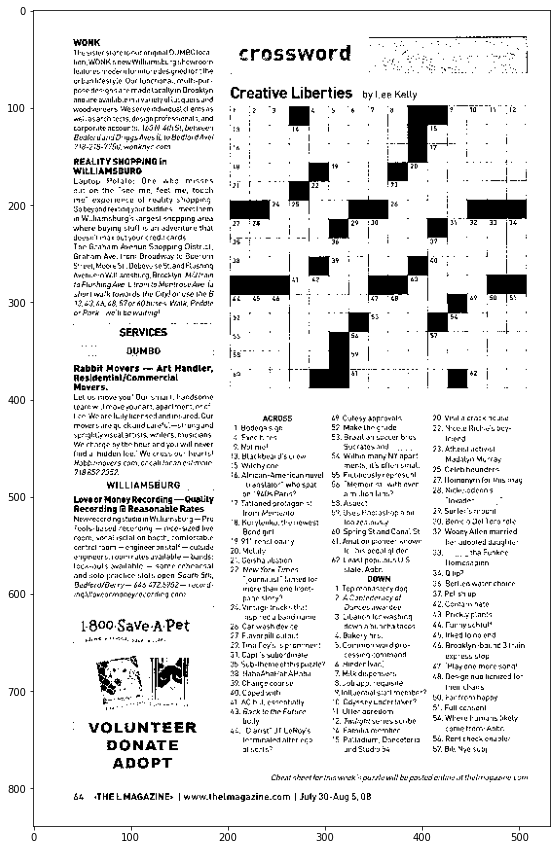

In [62]:
ret,th1 = cv2.threshold(img,127,255,cv2.THRESH_BINARY)
show_pic(th1)

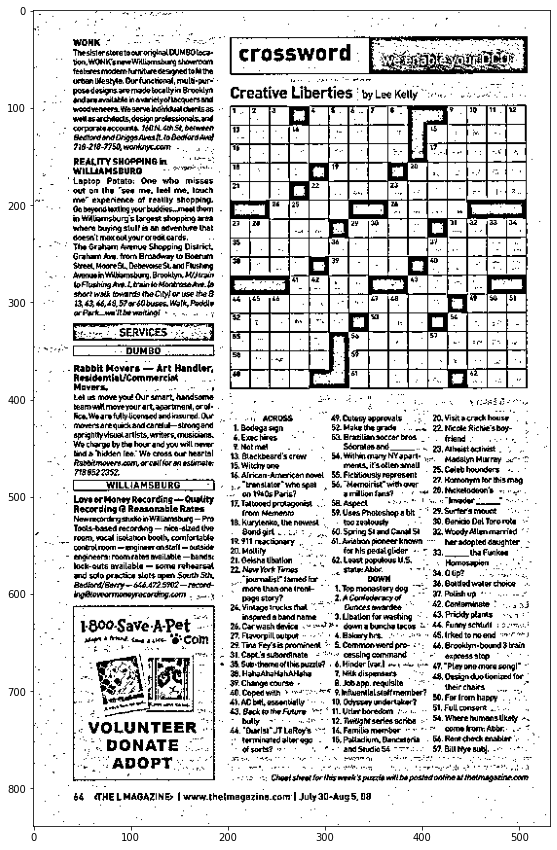

In [63]:
th2 = cv2.adaptiveThreshold(img, 255, cv2.ADAPTIVE_THRESH_MEAN_C, cv2.THRESH_BINARY, 11, 8)
show_pic(th2)

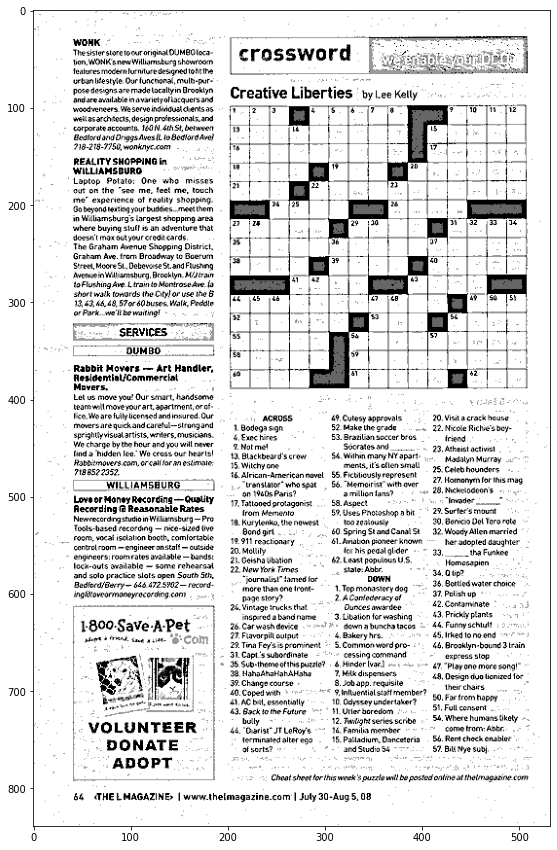

In [65]:
blended = cv2.addWeighted(src1=th1, alpha=0.6, src2=th2, beta=0.4, gamma=0)
show_pic(blended)

# Blurring and Smoothing

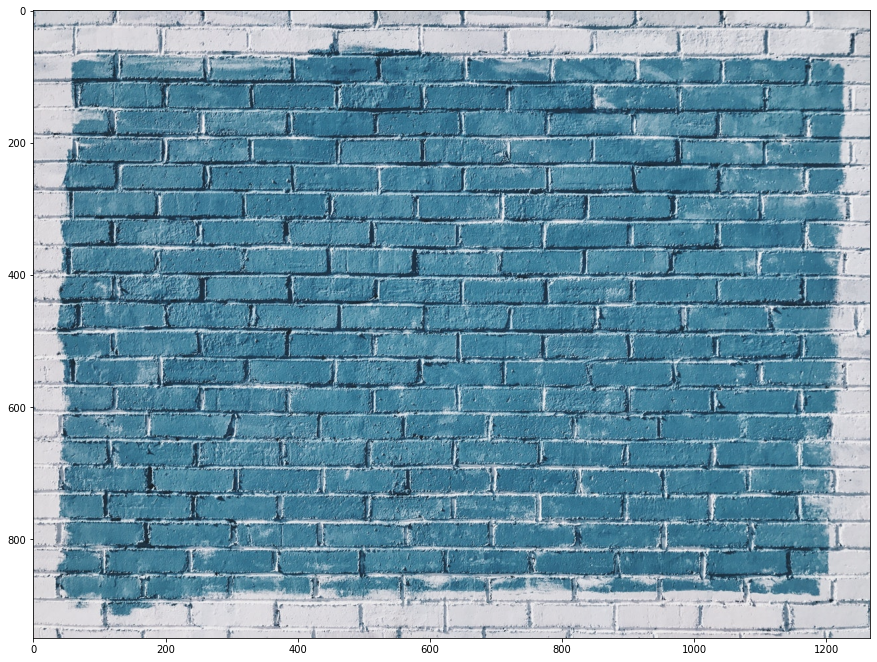

In [79]:
i = load_img()
display_img(i)

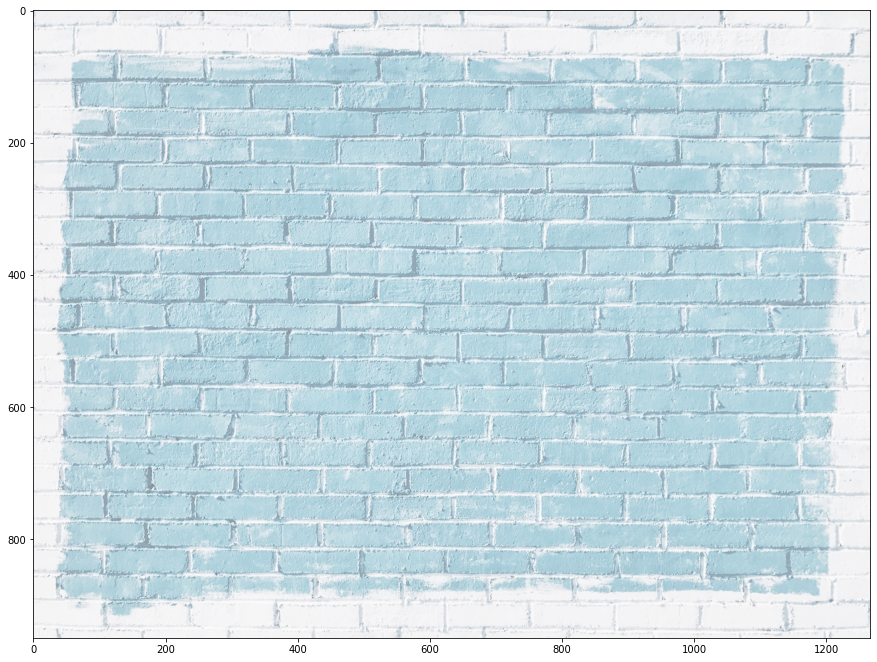

In [86]:
gama = 1 / 4
result = np.power(i, gama)
display_img(result)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


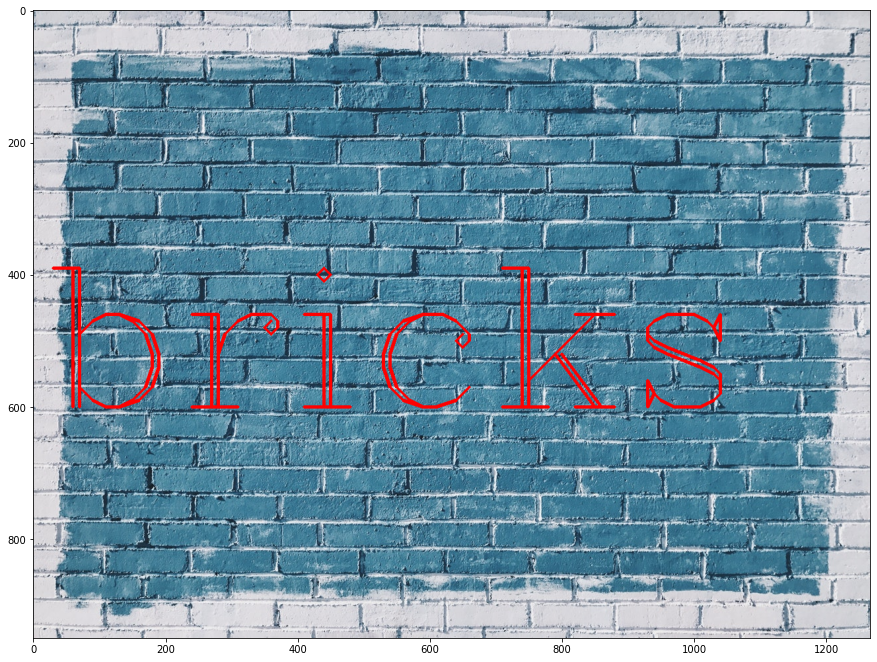

In [89]:
img = load_img()
font = cv2.FONT_HERSHEY_COMPLEX
cv2.putText(img,text='bricks',org=(10,600), fontFace=font, fontScale=10, color=(255,0,0), thickness=4)
display_img(img)

In [91]:
kernel = np.ones(shape=(5,5),dtype=np.float32)/25
kernel

array([[0.04, 0.04, 0.04, 0.04, 0.04],
       [0.04, 0.04, 0.04, 0.04, 0.04],
       [0.04, 0.04, 0.04, 0.04, 0.04],
       [0.04, 0.04, 0.04, 0.04, 0.04],
       [0.04, 0.04, 0.04, 0.04, 0.04]], dtype=float32)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


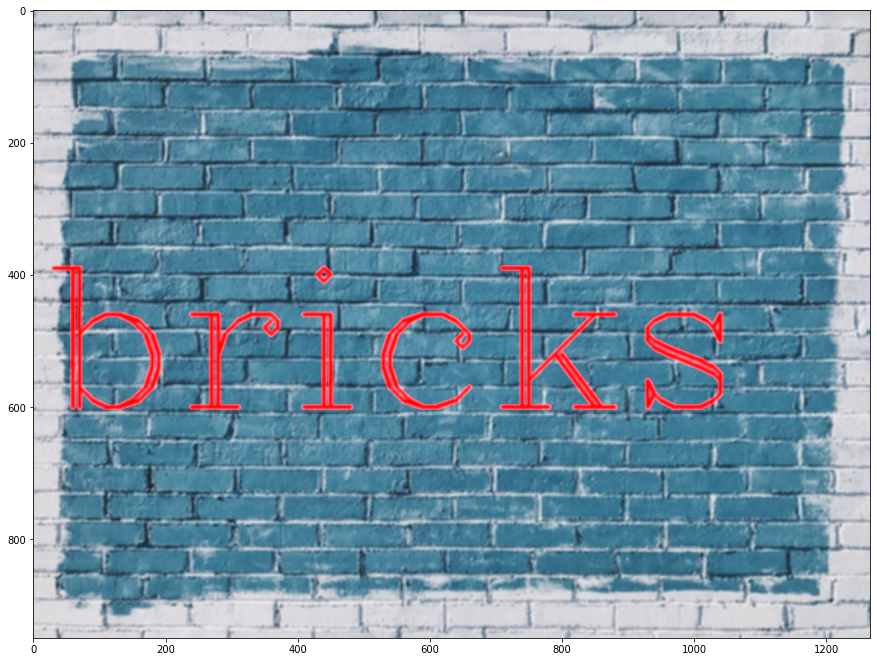

In [93]:
dst = cv2.filter2D(img, -1, kernel)
display_img(dst)

In [96]:
img = load_img()
font = cv2.FONT_HERSHEY_COMPLEX
cv2.putText(img,text='bbricks',org=(10,600), fontFace=font, fontScale=10, color=(255,0,0), thickness=4)
print('reset')

reset


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


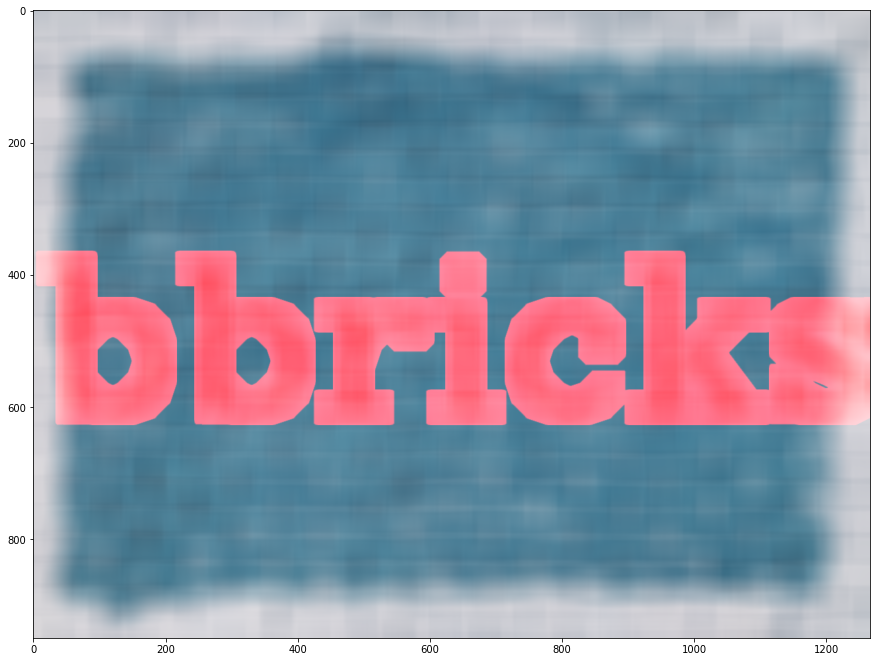

In [101]:
blurred = cv2.blur(img,ksize=(50,50))
display_img(blurred)

In [102]:
img = load_img()
font = cv2.FONT_HERSHEY_COMPLEX
cv2.putText(img,text='bbricks',org=(10,600), fontFace=font, fontScale=10, color=(255,0,0), thickness=4)
print('reset')

reset


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


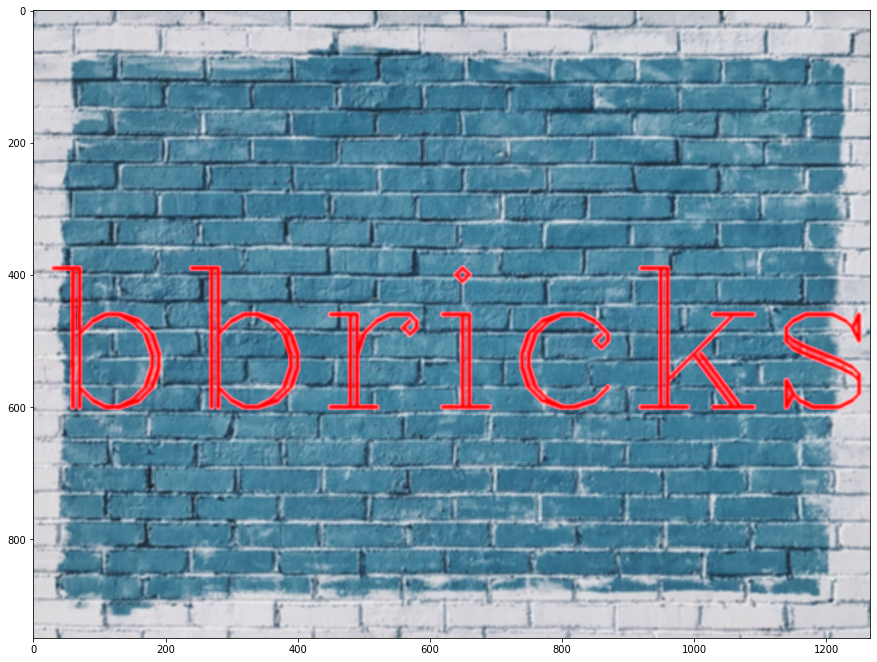

In [103]:
blurred_img = cv2.GaussianBlur(img,(5,5),10)
display_img(blurred_img)

In [104]:
img = load_img()
font = cv2.FONT_HERSHEY_COMPLEX
cv2.putText(img,text='bbricks',org=(10,600), fontFace=font, fontScale=10, color=(255,0,0), thickness=4)
print('reset')

reset


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


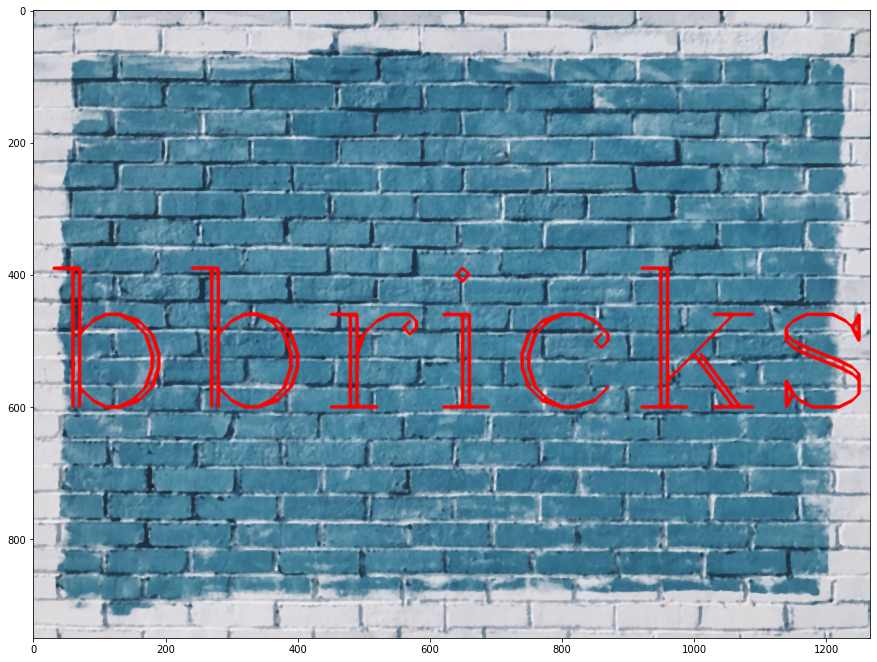

In [105]:
median_result = cv2.medianBlur(img, 5)
display_img(median_result)

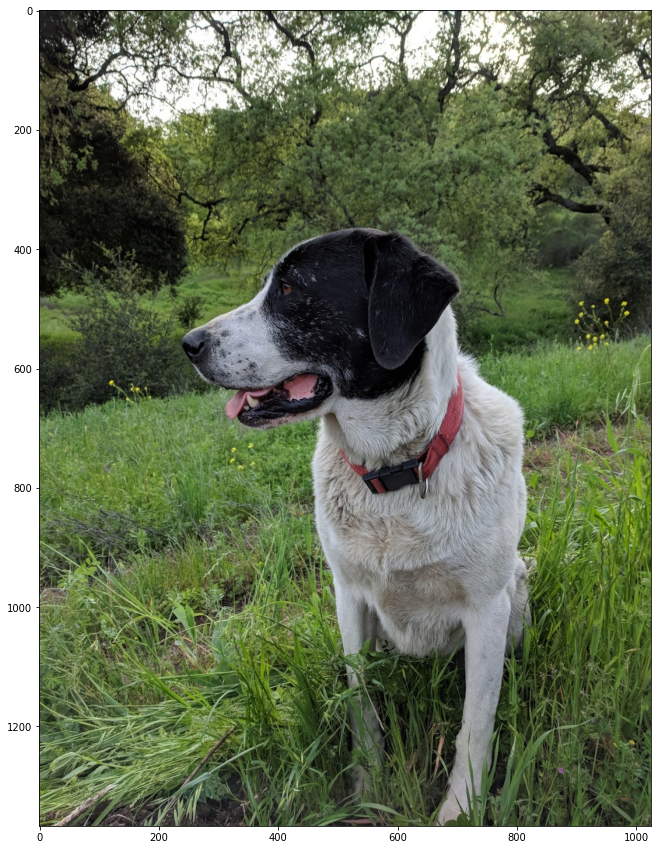

In [108]:
img = cv2.imread('../DATA/sammy.jpg')
img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
display_img(img)

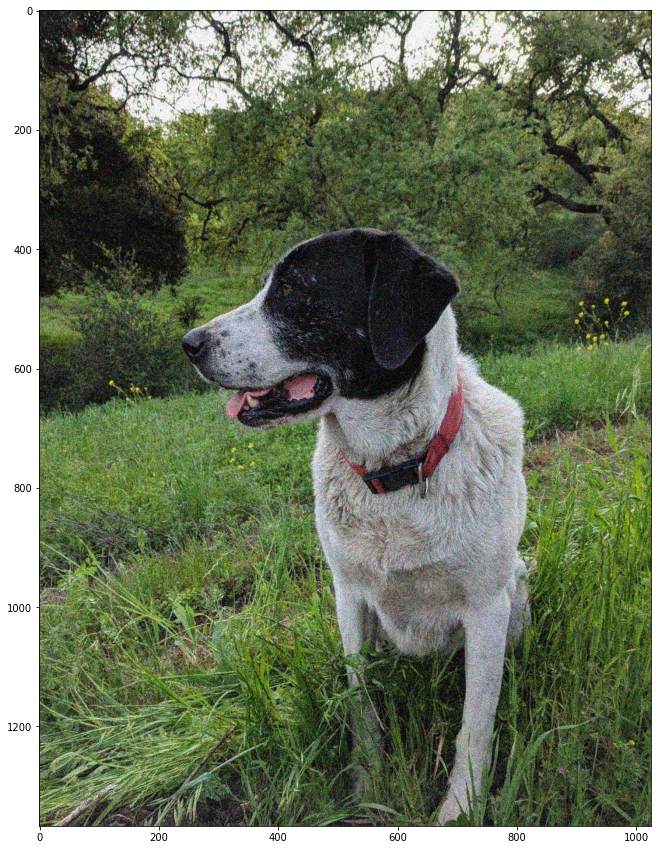

In [110]:
noise_img = cv2.imread('../DATA/sammy_noise.jpg')
display_img(noise_img)

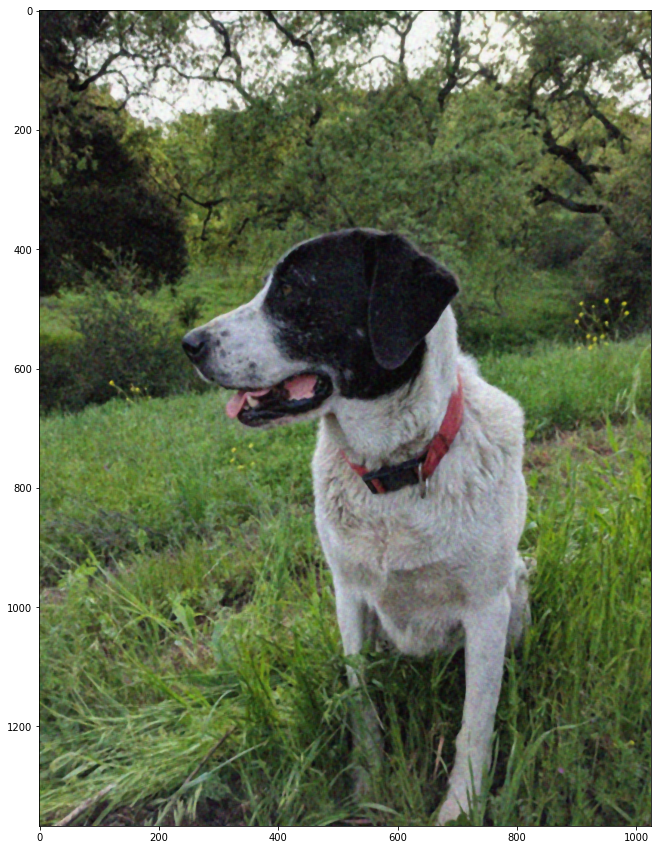

In [111]:
median = cv2.medianBlur(noise_img, 5)
display_img(median)

In [112]:
img = load_img()
font = cv2.FONT_HERSHEY_COMPLEX
cv2.putText(img,text='bbricks',org=(10,600), fontFace=font, fontScale=10, color=(255,0,0), thickness=4)
print('reset')

reset


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


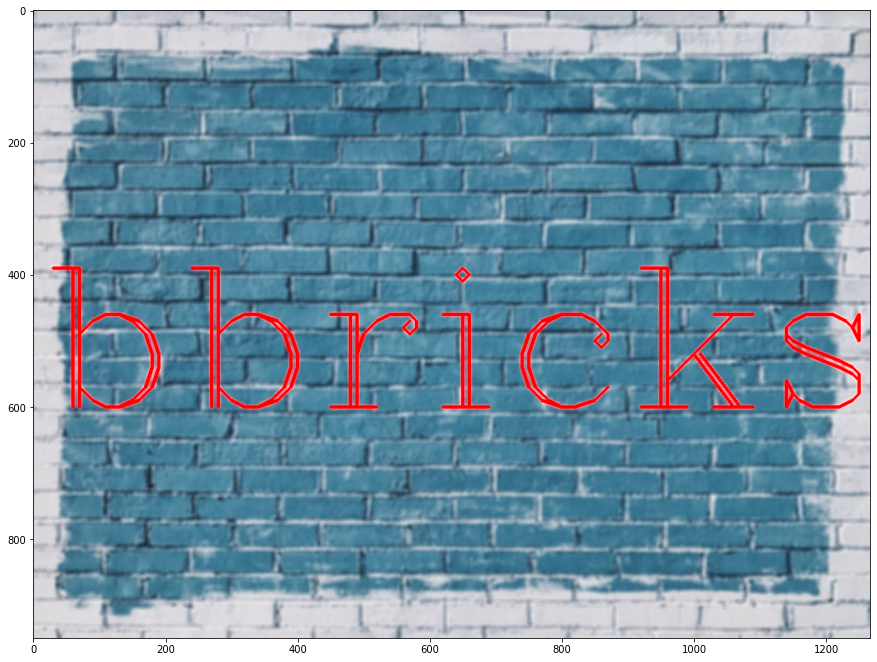

In [115]:
blur = cv2.bilateralFilter(img, 9, 75, 75)
display_img(blur)

# Morphological Operators

In [8]:
def load_img():
    blank_img =np.zeros((600,600))
    font = cv2.FONT_HERSHEY_SIMPLEX
    cv2.putText(blank_img,text='ABCDE',org=(50,300), fontFace=font,fontScale= 5,color=(255,255,255),thickness=25,lineType=cv2.LINE_AA)
    return blank_img


def display_img(img):
    fig = plt.figure(figsize=(15,15))
    ax = fig.add_subplot(111)
    ax.imshow(img, cmap='gray')

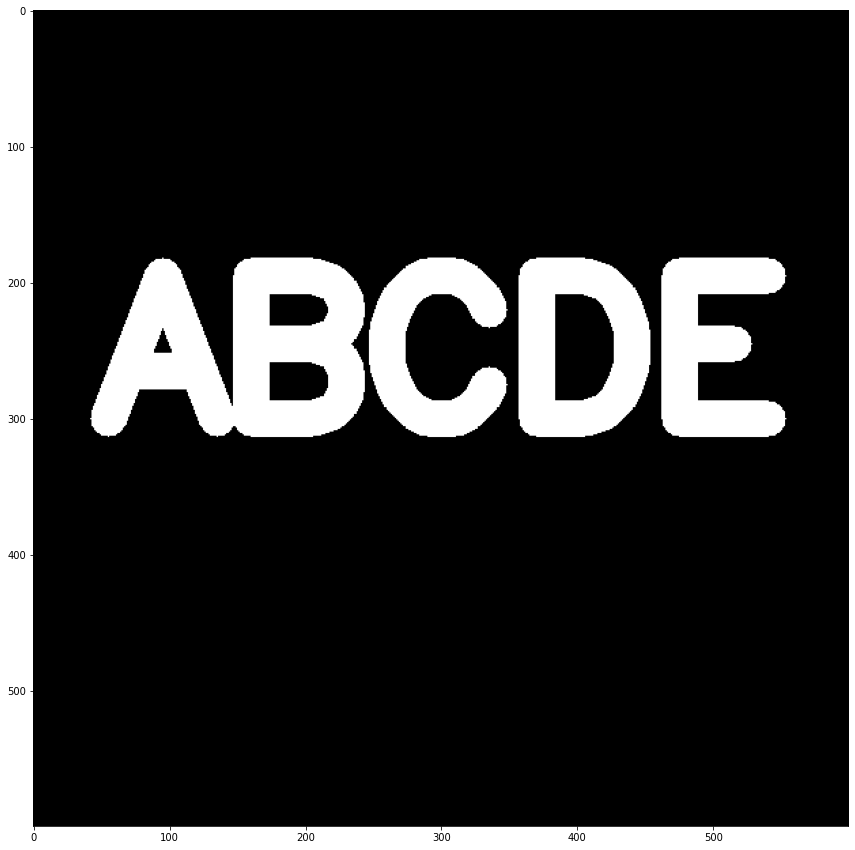

In [16]:
img = load_img()
display_img(img)

In [17]:
kernel = np.ones((5,5),dtype=np.uint8)
kernel

array([[1, 1, 1, 1, 1],
       [1, 1, 1, 1, 1],
       [1, 1, 1, 1, 1],
       [1, 1, 1, 1, 1],
       [1, 1, 1, 1, 1]], dtype=uint8)

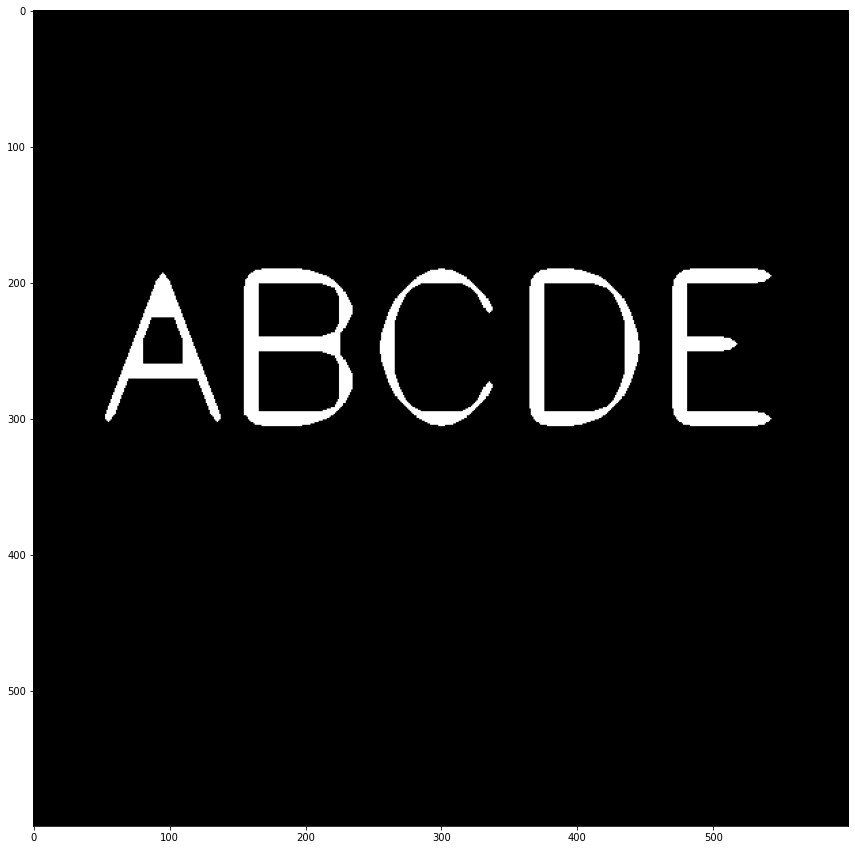

In [18]:
result = cv2.erode(img,kernel, iterations=4)
display_img(result)

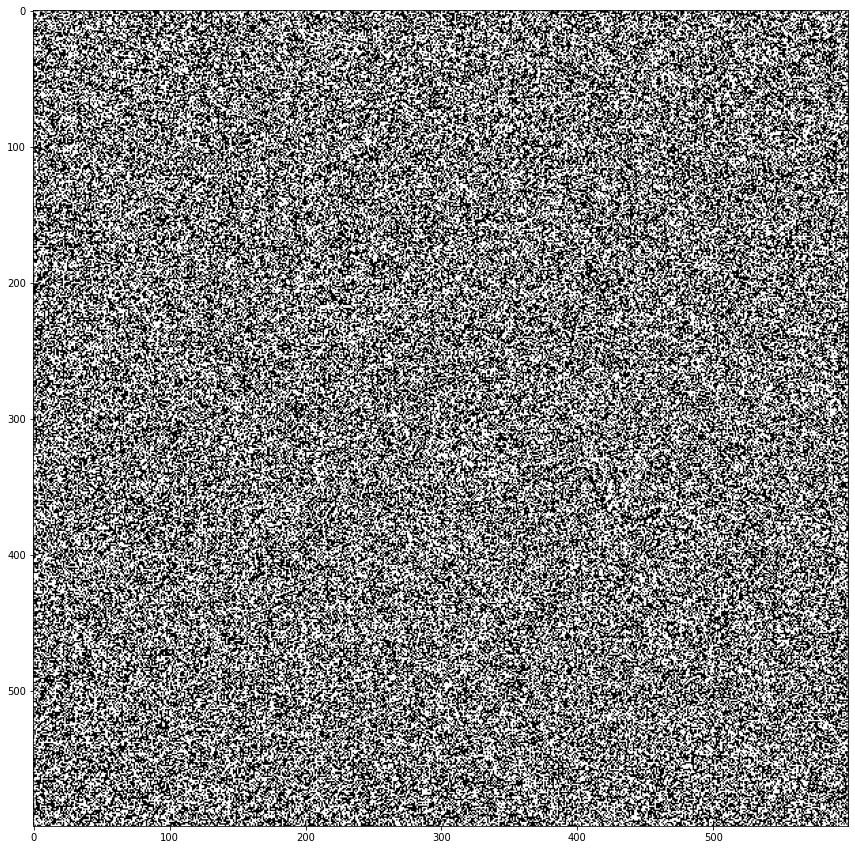

In [24]:
img = load_img()

white_noise = np.random.randint(low=0, high=2, size=(600,600)) * 255
display_img(white_noise)

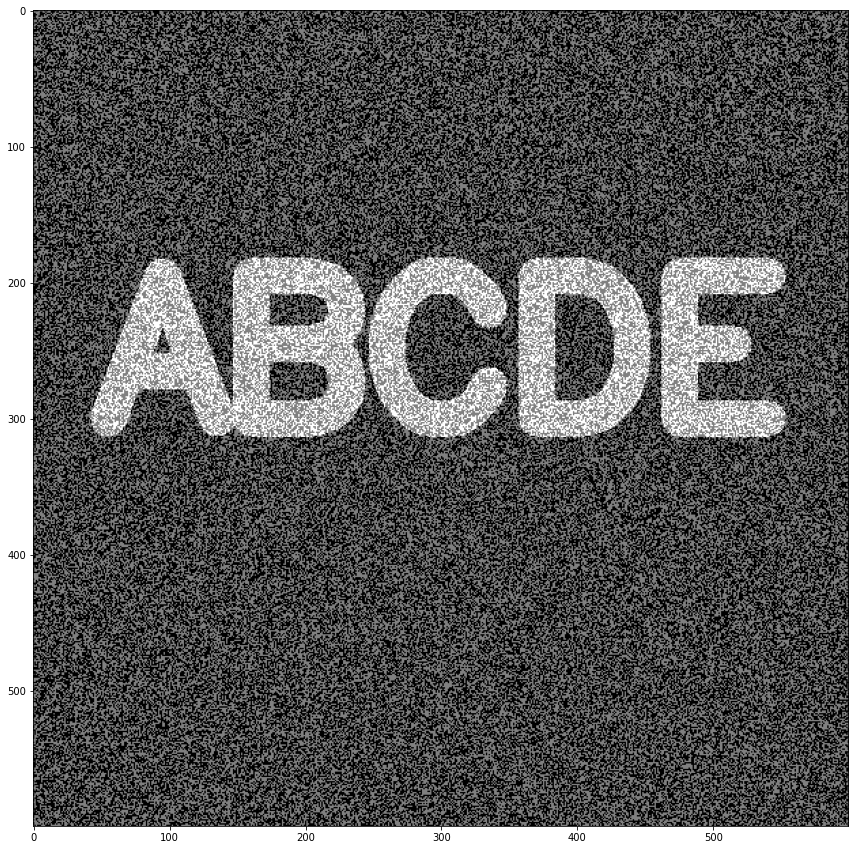

In [25]:
noise_img = white_noise + img

display_img(noise_img)

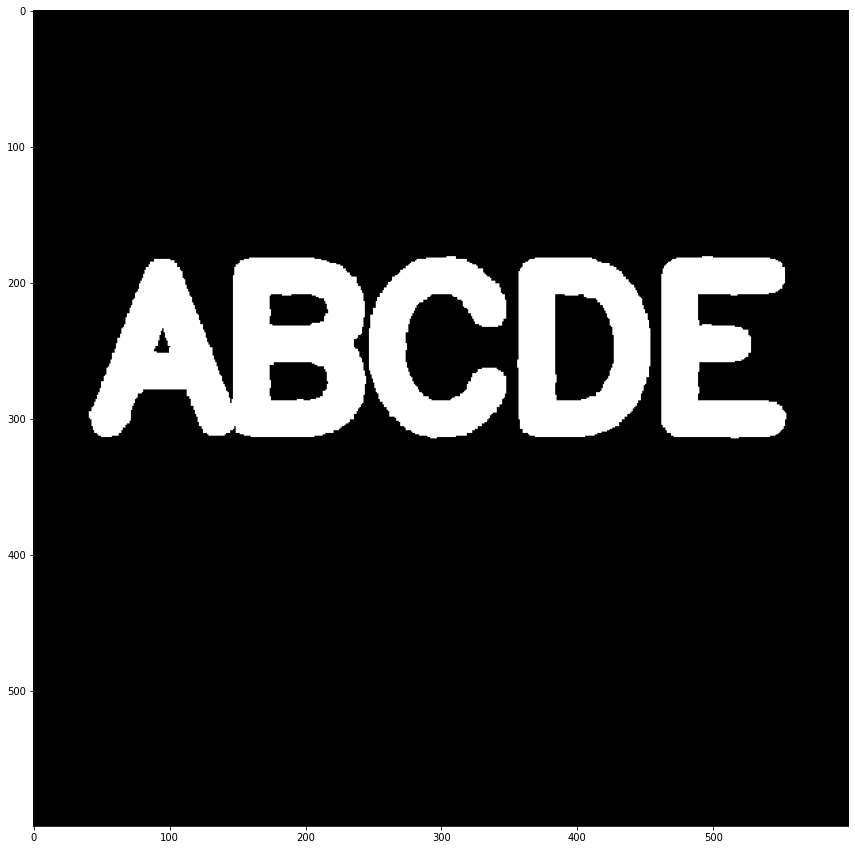

In [26]:
opening = cv2.morphologyEx(noise_img, cv2.MORPH_OPEN, kernel)
display_img(opening)

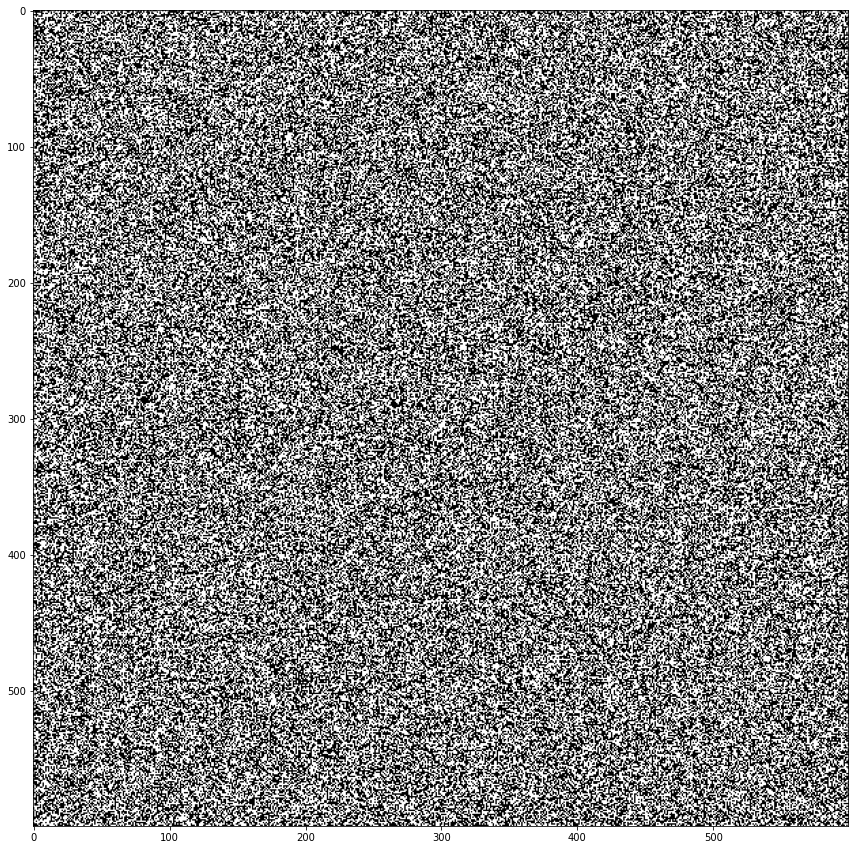

In [28]:
img = load_img()

black_noise = np.random.randint(low=0,high=2,size=(600,600)) * -255

display_img(black_noise)

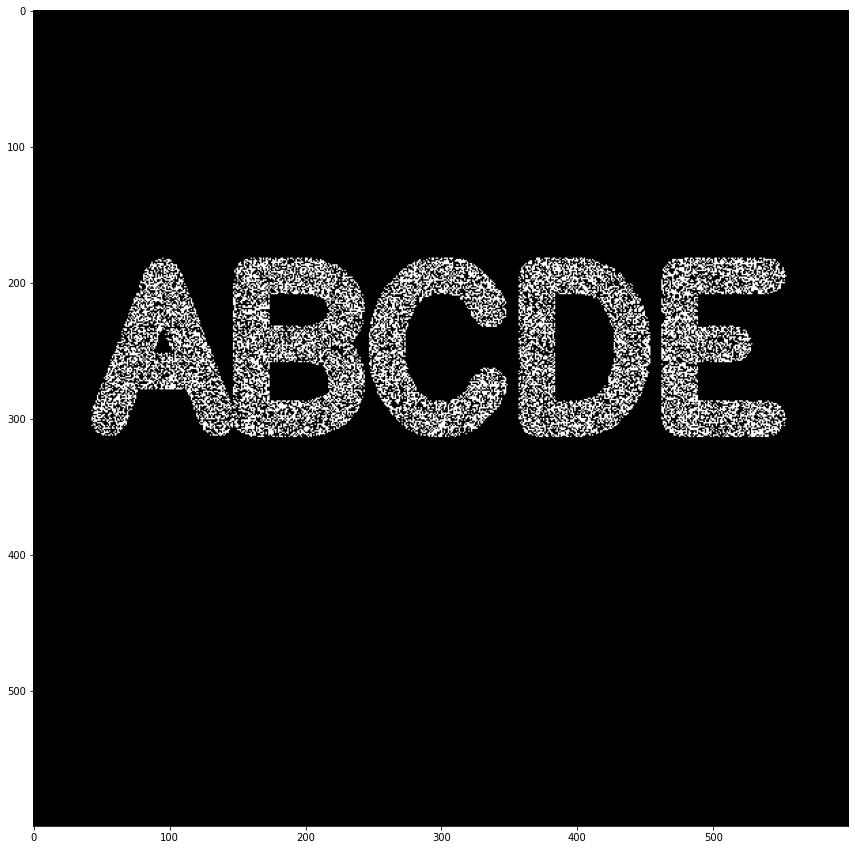

In [32]:
black_noise_img = img + black_noise
black_noise_img[black_noise_img == -255] = 0
display_img(black_noise_img)

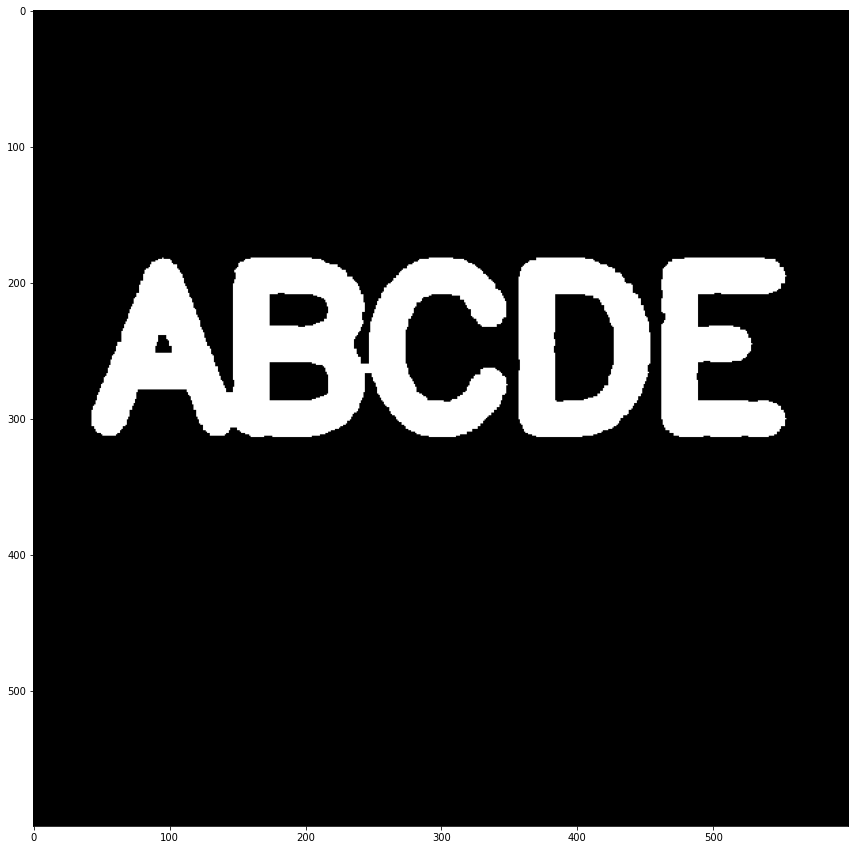

In [33]:
closing = cv2.morphologyEx(black_noise_img, cv2.MORPH_CLOSE,kernel)
display_img(closing)

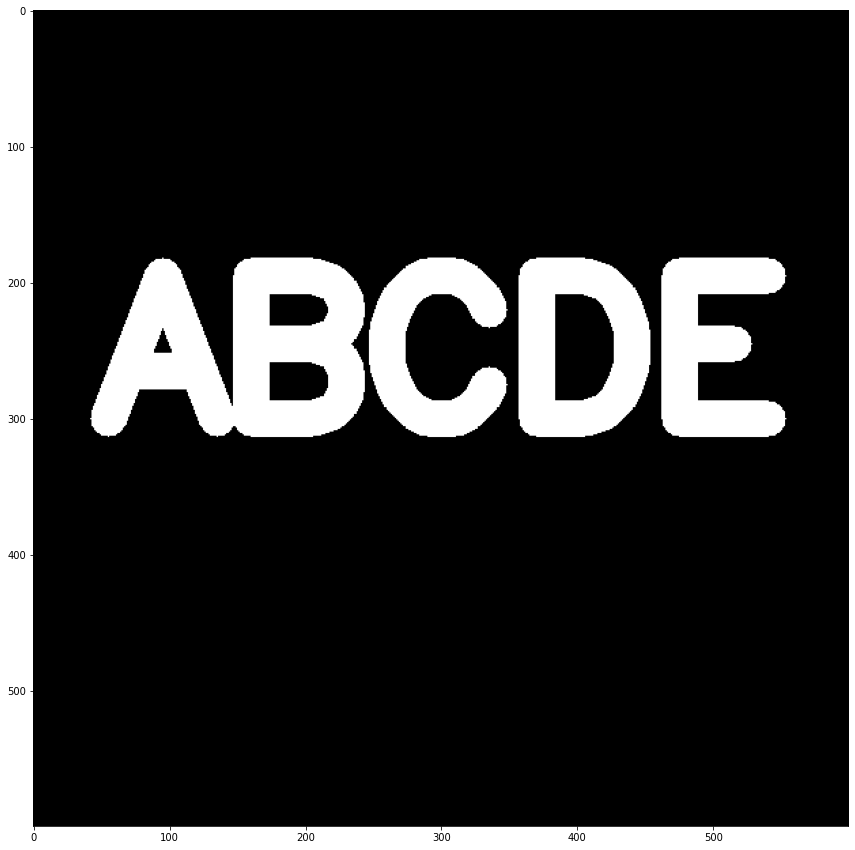

In [35]:
img = load_img()
display_img(img)

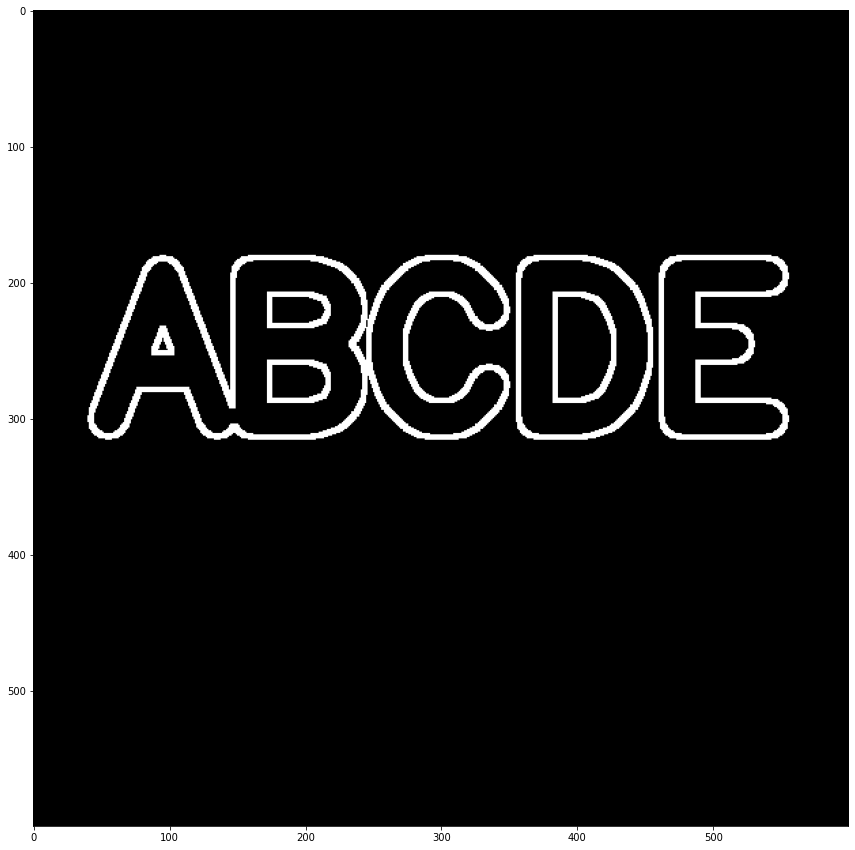

In [36]:
gradient = cv2.morphologyEx(img, cv2.MORPH_GRADIENT, kernel)
display_img(gradient)

# Gradients

In [37]:
def display_img(img):
    fig = plt.figure(figsize=(12,10))
    ax = fig.add_subplot(111)
    ax.imshow(img,cmap='gray')

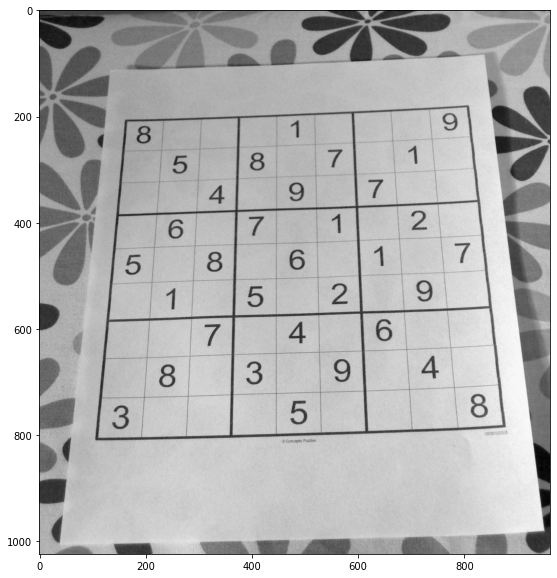

In [40]:
img = cv2.imread('../DATA/sudoku.jpg', 0)

display_img(img)

In [41]:
sobelx = cv2.Sobel(img, cv2.CV_64F, 1, 0, ksize=5)

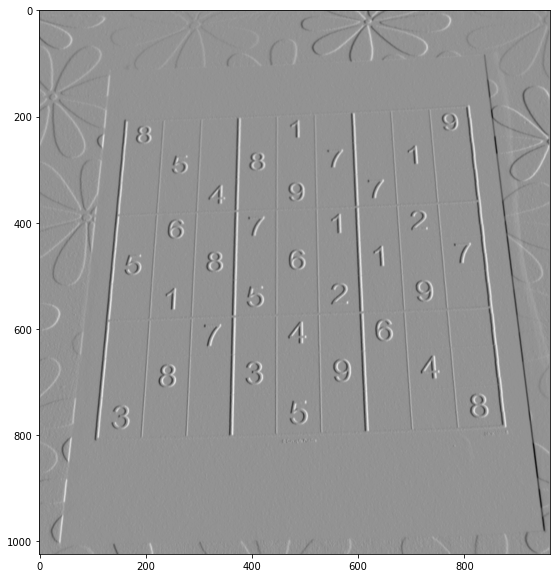

In [42]:
display_img(sobelx)

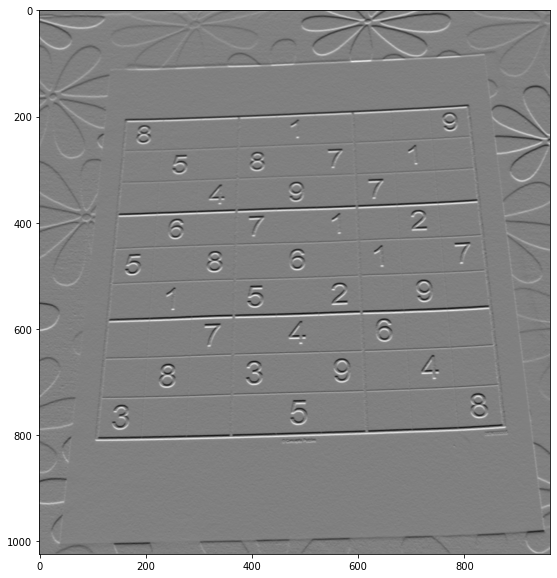

In [43]:
sobely = cv2.Sobel(img, cv2.CV_64F, 0, 1, ksize=5)
display_img(sobely)

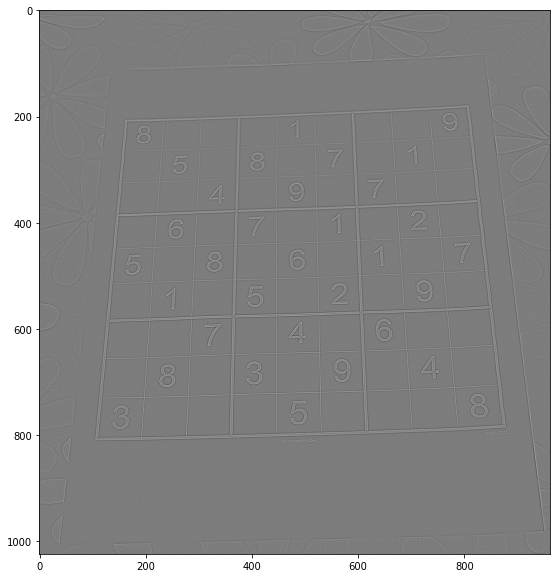

In [44]:
laplacian = cv2.Laplacian(img, cv2.CV_64F)
display_img(laplacian)

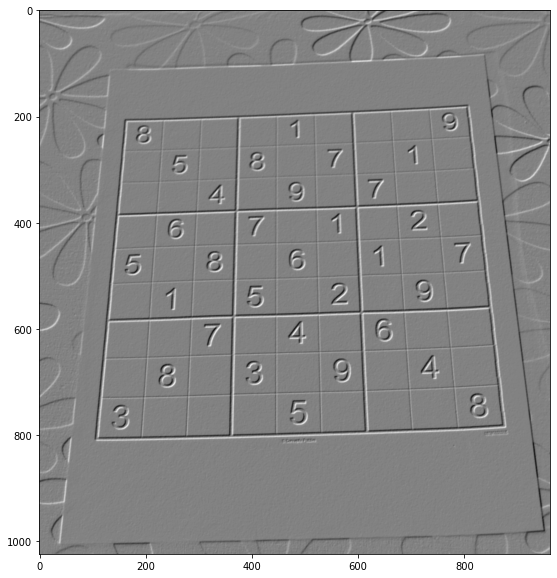

In [46]:
blended = cv2.addWeighted(src1=sobelx, src2=sobely, alpha=0.5,beta=0.5,gamma=0)

display_img(blended)

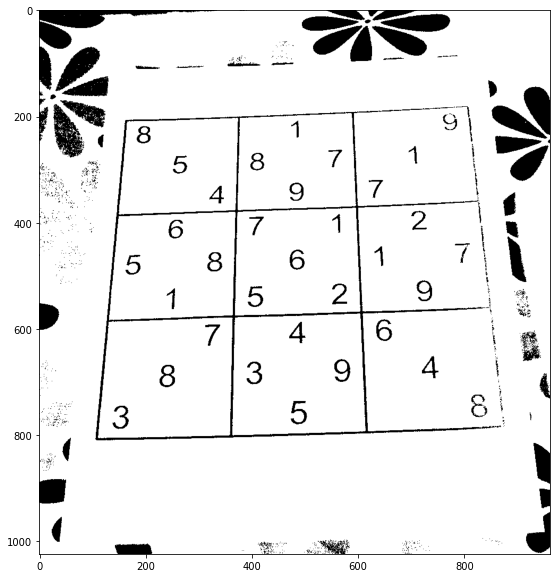

In [47]:
ret, th1 = cv2.threshold(img, 100, 255, cv2.THRESH_BINARY)
display_img(th1)

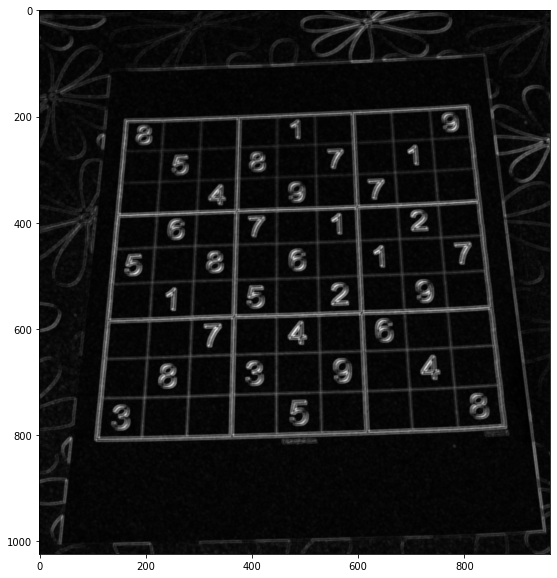

In [52]:
kernel = np.ones((4,4), np.uint8)

gradient = cv2.morphologyEx(blended, cv2.MORPH_GRADIENT, kernel)
display_img(gradient)

# Histogram

In [54]:
dark_horse = cv2.imread('../DATA/horse.jpg') # ORIGINAL BGR for OPENCV
show_horse = cv2.cvtColor(dark_horse, cv2.COLOR_BGR2RGB)# CONVERTED TO RGB for display

rainbow = cv2.imread('../DATA/rainbow.jpg')
show_rainbow =cv2.cvtColor(rainbow, cv2.COLOR_BGR2RGB)

blue_bricks = cv2.imread('../DATA/bricks.jpg')
show_bricks = cv2.cvtColor(blue_bricks, cv2.COLOR_BGR2RGB)

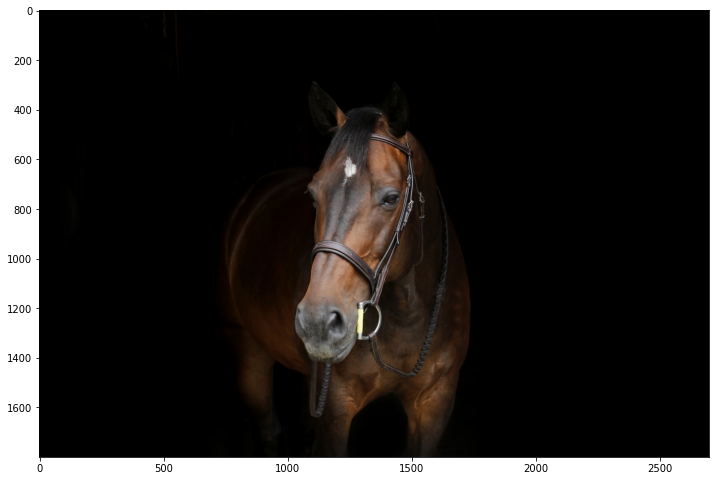

In [56]:
display_img(show_horse)

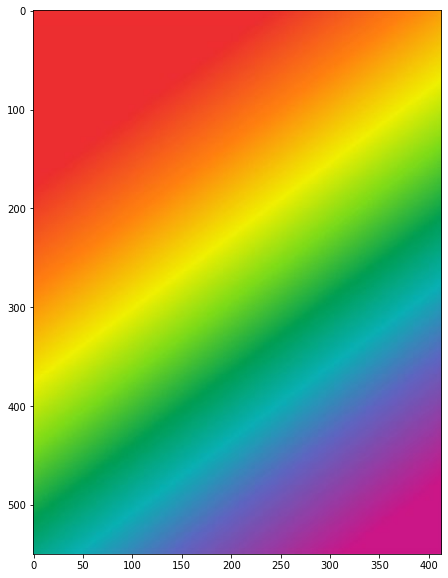

In [57]:
display_img(show_rainbow)

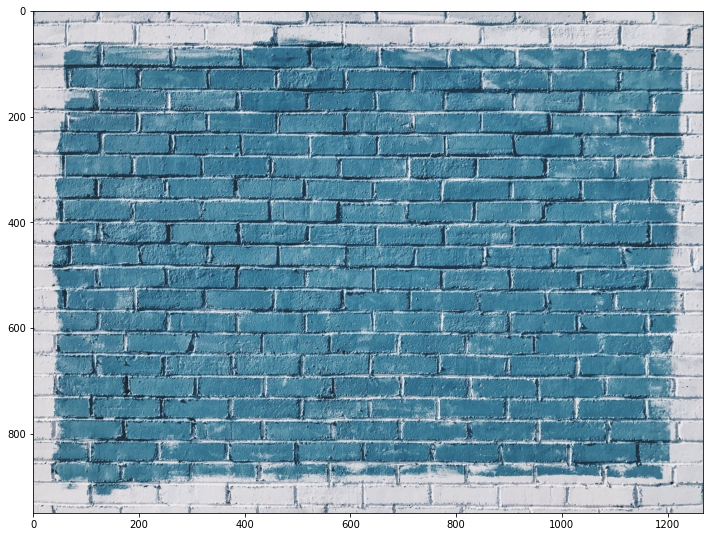

In [58]:
display_img(show_bricks)

In [59]:
hist_values = cv2.calcHist([blue_bricks], channels=[0], mask=None, histSize=[256], ranges=[0, 256])

In [61]:
hist_values.shape

(256, 1)

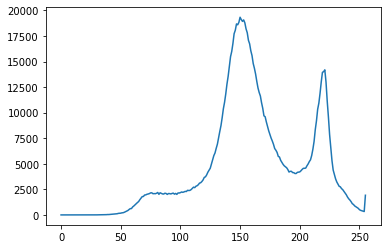

In [62]:
plt.plot(hist_values)

In [63]:
hist_values = cv2.calcHist([dark_horse], channels=[0], mask=None, histSize=[256], ranges=[0, 256])

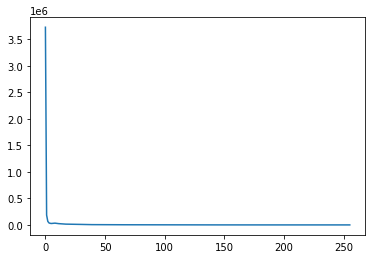

In [64]:
plt.plot(hist_values)

In [65]:
img = blue_bricks

Text(0.5, 1.0, 'HISTOGRAM FOR BLUE BRICKS')

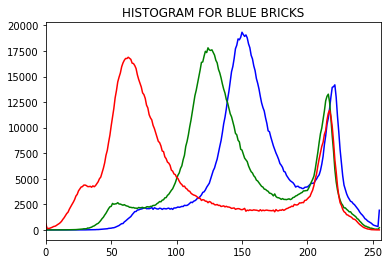

In [67]:
color = ('b', 'g', 'r')

for i, col in enumerate(color):
    histr = cv2.calcHist([img],[i],None,[256],[0,256])
    plt.plot(histr, color=col)
    plt.xlim([0,256])
plt.title('HISTOGRAM FOR BLUE BRICKS')

Text(0.5, 1.0, 'HISTOGRAM FOR HORSE')

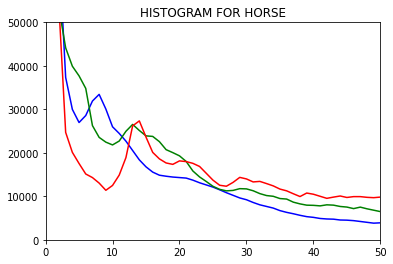

In [73]:
img = dark_horse
color = ('b', 'g', 'r')

for i, col in enumerate(color):
    histr = cv2.calcHist([img],[i],None,[256],[0,256])
    plt.plot(histr, color=col)
    plt.xlim([0,50])
    plt.ylim([0, 50000])
plt.title('HISTOGRAM FOR HORSE')

In [74]:
rainbow = cv2.imread('../DATA/rainbow.jpg')
show_rainbow =cv2.cvtColor(rainbow, cv2.COLOR_BGR2RGB)

In [75]:
img = rainbow
img.shape

(550, 413, 3)

In [79]:
mask = np.zeros(img.shape[:2], np.uint8)

In [80]:
mask[300:400,100:400] = 255

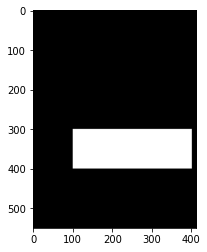

In [82]:
plt.imshow(mask, cmap='gray')

In [83]:
masked_img = cv2.bitwise_and(img,img,mask=mask)
show_masked_img = cv2.bitwise_and(show_rainbow, show_rainbow, mask=mask)

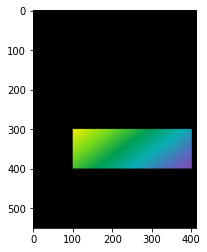

In [85]:
plt.imshow(show_masked_img)

In [86]:
hist_mask_values_red = cv2.calcHist([rainbow], channels=[2], mask=mask, histSize=[256], ranges=[0, 256])
hist_values_red = cv2.calcHist([rainbow], channels=[2], mask=None, histSize=[256], ranges=[0, 256])

Text(0.5, 1.0, 'RED HISTOGRAM for MASKED RAINBOW')

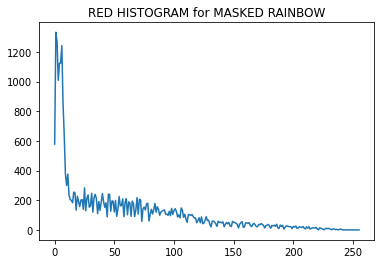

In [87]:
plt.plot(hist_mask_values_red)
plt.title('RED HISTOGRAM for MASKED RAINBOW')

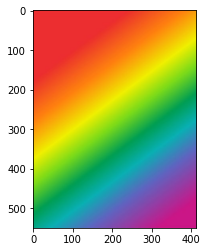

In [88]:
plt.imshow(show_rainbow)

Text(0.5, 1.0, 'RED HISTOGRAM for RAINBOW')

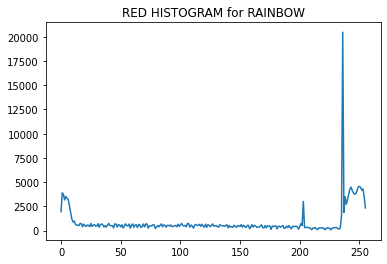

In [89]:
plt.plot(hist_values_red)
plt.title('RED HISTOGRAM for RAINBOW')

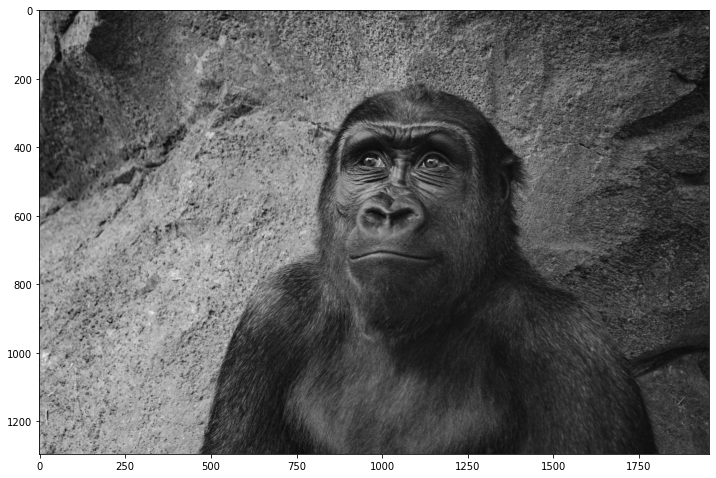

In [90]:
gorilla = cv2.imread('../DATA/gorilla.jpg', 0)
display_img(gorilla)

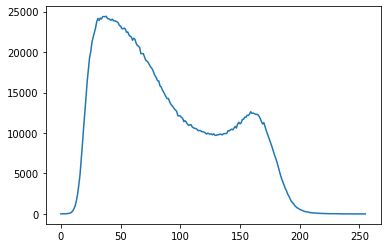

In [92]:
hist_values = cv2.calcHist([gorilla], channels=[0], mask=None, histSize=[256], ranges=[0, 256])
plt.plot(hist_values)

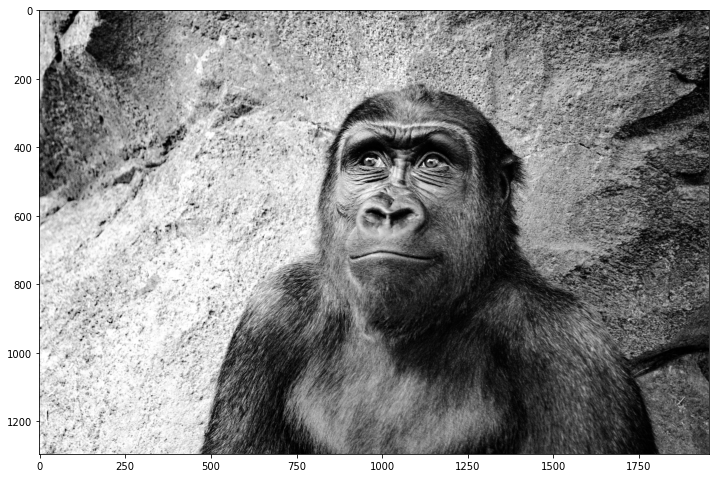

In [93]:
eq_gorilla = cv2.equalizeHist(gorilla)
display_img(eq_gorilla)

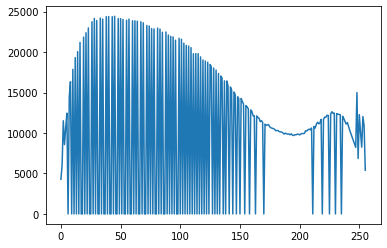

In [94]:
hist_values = cv2.calcHist([eq_gorilla], channels=[0], mask=None, histSize=[256], ranges=[0, 256])
plt.plot(hist_values)

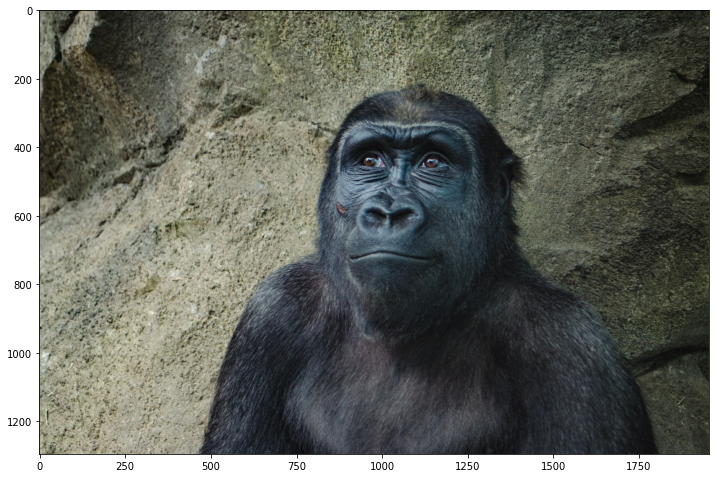

In [97]:
color_gorilla = cv2.imread('../DATA/gorilla.jpg')
show_gorilla = cv2.cvtColor(color_gorilla, cv2.COLOR_BGR2RGB)
display_img(show_gorilla)

In [98]:
hsv = cv2.cvtColor(color_gorilla, cv2.COLOR_BGR2HSV)

In [99]:
hsv[:,:,2].min()

1

In [100]:
hsv[:,:,2] = cv2.equalizeHist(hsv[:,:,2])

In [101]:
eq_color_gorilla = cv2.cvtColor(hsv, cv2.COLOR_HSV2RGB)

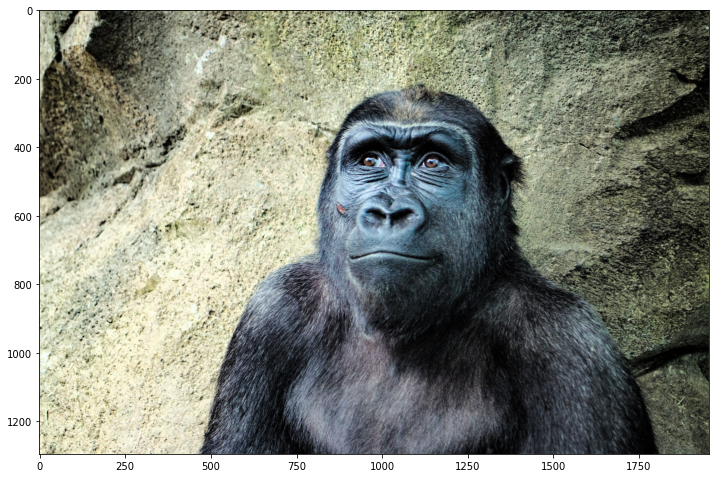

In [103]:
display_img(eq_color_gorilla)